In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

In [2]:
fileName = 'vehicle_emission_1.xls'
rawDataset = pd.read_excel(fileName, index_col=0)
rawDataset

,SN,Make,Yr,FuelType,VehicleUse,CO,CO2,O2,HC,lamda,Study,OGEPA,Age,VehicleType,EUROII,NESREAI,AFR,NESREAII,EUROIII
N,,,,,,,,,,,,,,,,,,,
1,1,Honda,2006,Petrol,Commercial,0.00,13.5,1.55,0,1.08,Passed,Passed,8,Car,Passed,Passed,15.876,Passed,Passed
2,2,Honda,2007,Petrol,Commercial,0.00,14.7,0.08,10,1.00,Passed,Passed,7,Jeep,Passed,Passed,14.744,Passed,Passed
3,3,Toyota,2011,Petrol,Commercial,0.00,14.6,0.72,1,1.04,Passed,Passed,3,Car,Passed,Passed,15.244,Passed,Passed
4,4,Toyota,1998,Petrol,Official,0.00,10.2,3.15,1,1.22,Passed,Passed,16,Car,Passed,Passed,17.934,Passed,Passed
5,5,Toyota,2002,Petrol,Official,0.00,14.5,0.60,1,1.03,Passed,Passed,12,Car,Passed,Passed,15.141,Passed,Passed
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,Toyota,1987,Petrol,Private,4.49,5.8,11.29,603,1.51,Failed,Failed,27,Car,Failed,Failed,22.256,Passed,Failed
2762,2797,Toyota,2007,Petrol,Commercial,4.51,11.9,0.47,388,0.88,Failed,Failed,7,Car,Failed,Failed,12.995,Failed,Failed
2763,2798,Nissan,1984,Petrol,Private,4.51,10.9,1.55,203,0.93,Failed,Failed,30,Car,Failed,Failed,13.700,Failed,Failed


In [3]:
rawDataset.columns

Index(['SN', 'Make', 'Yr', 'FuelType', 'VehicleUse', 'CO', 'CO2', 'O2', 'HC',
       'lamda', 'Study', 'OGEPA', 'Age', 'VehicleType', 'EUROII', 'NESREAI',
       'AFR', 'NESREAII', 'EUROIII'],
      dtype='object')

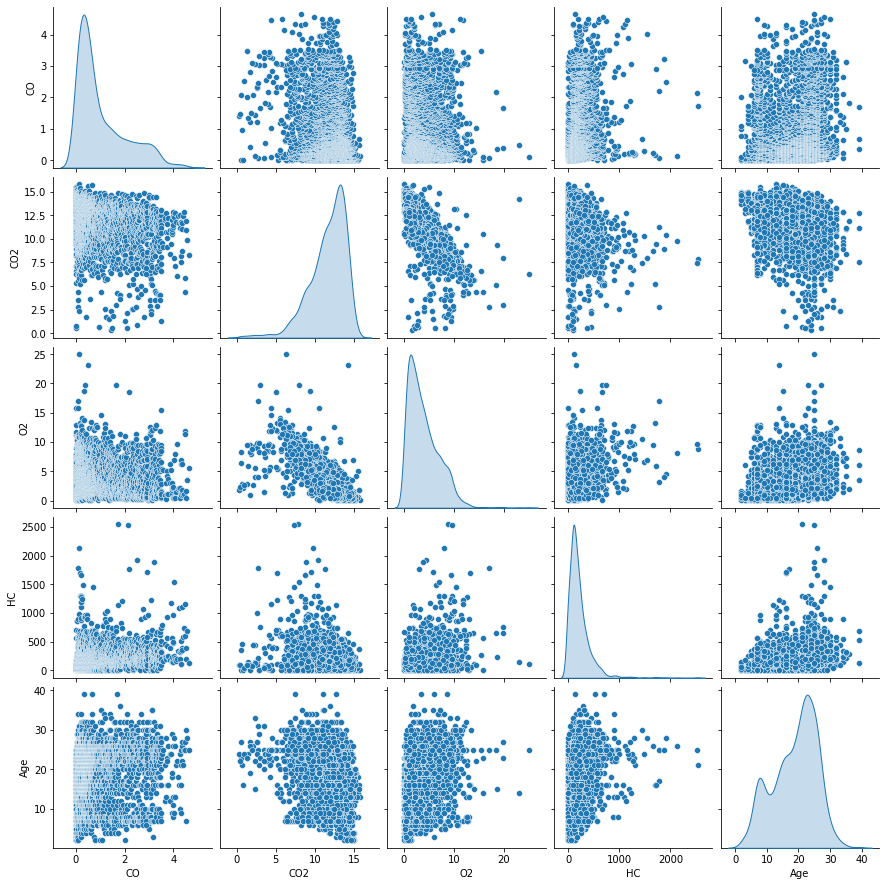

In [4]:
sns.pairplot(rawDataset[['CO', 'CO2', 'O2', 'HC', 'Age']], diag_kind='kde')

In [11]:
prefix = ['Make', 'FuelType', 'VehicleUse', 'Study', 'OGEPA', 'VehicleType', 'EUROII', 'NESREAI', 'NESREAII', 'EUROIII']

dataset = rawDataset.copy()
dataset = pd.get_dummies(dataset, prefix=prefix, prefix_sep='_')
dataset

,SN,Yr,CO,CO2,O2,HC,lamda,Age,AFR,Make_Honda,...,VehicleType_PICK-UP,VehicleType_TRUCK,EUROII_Failed,EUROII_Passed,NESREAI_Failed,NESREAI_Passed,NESREAII_Failed,NESREAII_Passed,EUROIII_Failed,EUROIII_Passed
N,,,,,,,,,,,,,,,,,,,,,
1,1,2006,0.00,13.5,1.55,0,1.08,8,15.876,1,...,0,0,0,1,0,1,0,1,0,1
2,2,2007,0.00,14.7,0.08,10,1.00,7,14.744,1,...,0,0,0,1,0,1,0,1,0,1
3,3,2011,0.00,14.6,0.72,1,1.04,3,15.244,0,...,0,0,0,1,0,1,0,1,0,1
4,4,1998,0.00,10.2,3.15,1,1.22,16,17.934,0,...,0,0,0,1,0,1,0,1,0,1
5,5,2002,0.00,14.5,0.60,1,1.03,12,15.141,0,...,0,0,0,1,0,1,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,1987,4.49,5.8,11.29,603,1.51,27,22.256,0,...,0,0,1,0,1,0,0,1,1,0
2762,2797,2007,4.51,11.9,0.47,388,0.88,7,12.995,0,...,0,0,1,0,1,0,1,0,1,0
2763,2798,1984,4.51,10.9,1.55,203,0.93,30,13.700,0,...,0,0,1,0,1,0,1,0,1,0


In [12]:
from sklearn.preprocessing import StandardScaler

data = dataset[['Age','CO','CO2','O2','HC']].to_numpy()

scaler = StandardScaler()
print(scaler.fit(data))
print(scaler.mean_)

data_normalized = scaler.transform(data)

df2 = pd.DataFrame(data_normalized)

# start index
df2.index += 1
df2.columns = ['Age_0','CO_0','CO2_0','O2_0','HC_0']
dataset = pd.concat([dataset, df2], axis=1)

dataset

StandardScaler()
[ 18.84448463   1.03710307  11.62610127   3.96343942 210.36491863]


,SN,Yr,CO,CO2,O2,HC,lamda,Age,AFR,Make_Honda,...,NESREAI_Passed,NESREAII_Failed,NESREAII_Passed,EUROIII_Failed,EUROIII_Passed,Age_0,CO_0,CO2_0,O2_0,HC_0
1,1,2006,0.00,13.5,1.55,0,1.08,8,15.876,1,...,1,0,1,0,1,-1.580129,-1.020741,0.792928,-0.800109,-0.966827
2,2,2007,0.00,14.7,0.08,10,1.00,7,14.744,1,...,1,0,1,0,1,-1.725837,-1.020741,1.300700,-1.287446,-0.920867
3,3,2011,0.00,14.6,0.72,1,1.04,3,15.244,0,...,1,0,1,0,1,-2.308669,-1.020741,1.258386,-1.075272,-0.962231
4,4,1998,0.00,10.2,3.15,1,1.22,16,17.934,0,...,1,0,1,0,1,-0.414464,-1.020741,-0.603445,-0.269673,-0.962231
5,5,2002,0.00,14.5,0.60,1,1.03,12,15.141,0,...,1,0,1,0,1,-0.997296,-1.020741,1.216071,-1.115055,-0.962231
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,1987,4.49,5.8,11.29,603,1.51,27,22.256,0,...,0,0,1,1,0,1.188324,3.398422,-2.465276,2.428917,1.804531
2762,2797,2007,4.51,11.9,0.47,388,0.88,7,12.995,0,...,0,1,0,1,0,-1.725837,3.418106,0.115898,-1.158153,0.816402
2763,2798,1984,4.51,10.9,1.55,203,0.93,30,13.700,0,...,0,1,0,1,0,1.625448,3.418106,-0.307245,-0.800109,-0.033849
2764,2799,1986,4.55,9.9,3.44,679,1.00,28,14.627,0,...,0,1,0,1,0,1.334032,3.457475,-0.730388,-0.173532,2.153824


In [13]:
from sklearn.preprocessing import MinMaxScaler

data = dataset[['Age','CO','CO2','O2','HC']].to_numpy()

scaler = MinMaxScaler()
print(scaler.fit(data))
print((scaler.data_min_, scaler.data_max_))

data_normalized = scaler.transform(data)

df2 = pd.DataFrame(data_normalized)

# start index
df2.index += 1
df2.columns = ['Age_1','CO_1','CO2_1','O2_1','HC_1']
dataset = pd.concat([dataset, df2], axis=1)

dataset

MinMaxScaler()
(array([2.  , 0.  , 0.3 , 0.02, 0.  ]), array([  39.  ,    4.65,   15.8 ,   25.  , 2547.  ]))


,SN,Yr,CO,CO2,O2,HC,lamda,Age,AFR,Make_Honda,...,Age_0,CO_0,CO2_0,O2_0,HC_0,Age_1,CO_1,CO2_1,O2_1,HC_1
1,1,2006,0.00,13.5,1.55,0,1.08,8,15.876,1,...,-1.580129,-1.020741,0.792928,-0.800109,-0.966827,0.162162,0.000000,0.851613,0.061249,0.000000
2,2,2007,0.00,14.7,0.08,10,1.00,7,14.744,1,...,-1.725837,-1.020741,1.300700,-1.287446,-0.920867,0.135135,0.000000,0.929032,0.002402,0.003926
3,3,2011,0.00,14.6,0.72,1,1.04,3,15.244,0,...,-2.308669,-1.020741,1.258386,-1.075272,-0.962231,0.027027,0.000000,0.922581,0.028022,0.000393
4,4,1998,0.00,10.2,3.15,1,1.22,16,17.934,0,...,-0.414464,-1.020741,-0.603445,-0.269673,-0.962231,0.378378,0.000000,0.638710,0.125300,0.000393
5,5,2002,0.00,14.5,0.60,1,1.03,12,15.141,0,...,-0.997296,-1.020741,1.216071,-1.115055,-0.962231,0.270270,0.000000,0.916129,0.023219,0.000393
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,1987,4.49,5.8,11.29,603,1.51,27,22.256,0,...,1.188324,3.398422,-2.465276,2.428917,1.804531,0.675676,0.965591,0.354839,0.451161,0.236749
2762,2797,2007,4.51,11.9,0.47,388,0.88,7,12.995,0,...,-1.725837,3.418106,0.115898,-1.158153,0.816402,0.135135,0.969892,0.748387,0.018014,0.152336
2763,2798,1984,4.51,10.9,1.55,203,0.93,30,13.700,0,...,1.625448,3.418106,-0.307245,-0.800109,-0.033849,0.756757,0.969892,0.683871,0.061249,0.079702
2764,2799,1986,4.55,9.9,3.44,679,1.00,28,14.627,0,...,1.334032,3.457475,-0.730388,-0.173532,2.153824,0.702703,0.978495,0.619355,0.136910,0.266588


In [14]:
import sklearn.preprocessing as preprocessing

X = dataset[['Age','CO','CO2','O2','HC']].to_numpy()
X_normalized = preprocessing.normalize(X, norm='l2')
# 
df2 = pd.DataFrame(X_normalized)
# start index
df2.index += 1
df2.columns = ['Age_2','CO_2','CO2_2','O2_2','HC_2']
dataset = pd.concat([dataset, df2], axis=1)

dataset

,SN,Yr,CO,CO2,O2,HC,lamda,Age,AFR,Make_Honda,...,Age_1,CO_1,CO2_1,O2_1,HC_1,Age_2,CO_2,CO2_2,O2_2,HC_2
1,1,2006,0.00,13.5,1.55,0,1.08,8,15.876,1,...,0.162162,0.000000,0.851613,0.061249,0.000000,0.507334,0.000000,0.856125,0.098296,0.000000
2,2,2007,0.00,14.7,0.08,10,1.00,7,14.744,1,...,0.135135,0.000000,0.929032,0.002402,0.003926,0.366348,0.000000,0.769332,0.004187,0.523355
3,3,2011,0.00,14.6,0.72,1,1.04,3,15.244,0,...,0.027027,0.000000,0.922581,0.028022,0.000393,0.200590,0.000000,0.976205,0.048142,0.066863
4,4,1998,0.00,10.2,3.15,1,1.22,16,17.934,0,...,0.378378,0.000000,0.638710,0.125300,0.000393,0.830721,0.000000,0.529584,0.163548,0.051920
5,5,2002,0.00,14.5,0.60,1,1.03,12,15.141,0,...,0.270270,0.000000,0.916129,0.023219,0.000393,0.636347,0.000000,0.768920,0.031817,0.053029
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,1987,4.49,5.8,11.29,603,1.51,27,22.256,0,...,0.675676,0.965591,0.354839,0.451161,0.236749,0.044720,0.007437,0.009607,0.018700,0.998751
2762,2797,2007,4.51,11.9,0.47,388,0.88,7,12.995,0,...,0.135135,0.969892,0.748387,0.018014,0.152336,0.018029,0.011616,0.030649,0.001210,0.999299
2763,2798,1984,4.51,10.9,1.55,203,0.93,30,13.700,0,...,0.756757,0.969892,0.683871,0.061249,0.079702,0.145950,0.021941,0.053029,0.007541,0.987597
2764,2799,1986,4.55,9.9,3.44,679,1.00,28,14.627,0,...,0.702703,0.978495,0.619355,0.136910,0.266588,0.041196,0.006694,0.014566,0.005061,0.999010


In [29]:
import sklearn.preprocessing as preprocessing

X = dataset[['Age','CO','CO2','O2','HC']].to_numpy().T
X_normalized = preprocessing.normalize(X, norm='l2')
# 
df2 = pd.DataFrame(X_normalized.T)
# start index
df2.index += 1
df2.columns = ['Age_3','CO_3','CO2_3','O2_3','HC_3']
dataset = pd.concat([dataset, df2], axis=1)

dataset

,SN,Yr,CO,CO2,O2,HC,lamda,Age,AFR,Make_Honda,...,Age_2,CO_2,CO2_2,O2_2,HC_2,Age_3,CO_3,CO2_3,O2_3,HC_3
1,1,2006,0.00,13.5,1.55,0,1.08,8,15.876,1,...,0.507334,0.000000,0.856125,0.098296,0.000000,0.007586,0.000000,0.021640,0.005918,0.000000
2,2,2007,0.00,14.7,0.08,10,1.00,7,14.744,1,...,0.366348,0.000000,0.769332,0.004187,0.523355,0.006638,0.000000,0.023564,0.000305,0.000628
3,3,2011,0.00,14.6,0.72,1,1.04,3,15.244,0,...,0.200590,0.000000,0.976205,0.048142,0.066863,0.002845,0.000000,0.023403,0.002749,0.000063
4,4,1998,0.00,10.2,3.15,1,1.22,16,17.934,0,...,0.830721,0.000000,0.529584,0.163548,0.051920,0.015172,0.000000,0.016350,0.012027,0.000063
5,5,2002,0.00,14.5,0.60,1,1.03,12,15.141,0,...,0.636347,0.000000,0.768920,0.031817,0.053029,0.011379,0.000000,0.023243,0.002291,0.000063
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,1987,4.49,5.8,11.29,603,1.51,27,22.256,0,...,0.044720,0.007437,0.009607,0.018700,0.998751,0.025603,0.058813,0.009297,0.043108,0.037891
2762,2797,2007,4.51,11.9,0.47,388,0.88,7,12.995,0,...,0.018029,0.011616,0.030649,0.001210,0.999299,0.006638,0.059075,0.019075,0.001795,0.024381
2763,2798,1984,4.51,10.9,1.55,203,0.93,30,13.700,0,...,0.145950,0.021941,0.053029,0.007541,0.987597,0.028447,0.059075,0.017472,0.005918,0.012756
2764,2799,1986,4.55,9.9,3.44,679,1.00,28,14.627,0,...,0.041196,0.006694,0.014566,0.005061,0.999010,0.026551,0.059599,0.015869,0.013135,0.042666


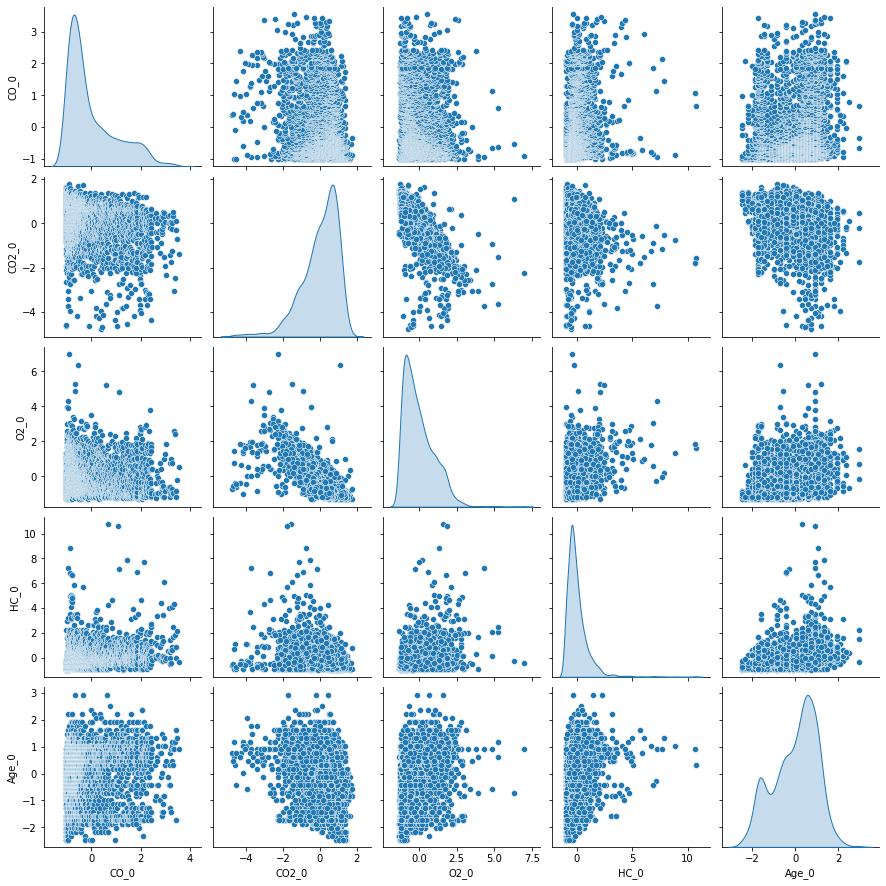

In [15]:
sns.pairplot(dataset[['CO_0', 'CO2_0', 'O2_0', 'HC_0', 'Age_0']], diag_kind='kde')

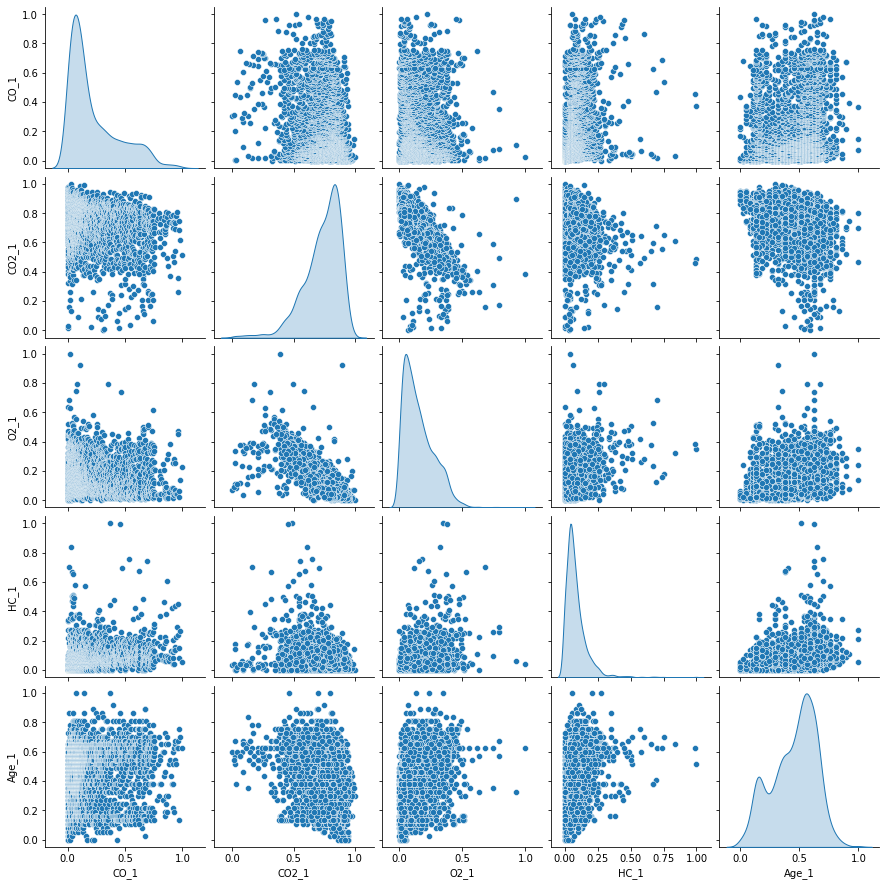

In [16]:
sns.pairplot(dataset[['CO_1', 'CO2_1', 'O2_1', 'HC_1', 'Age_1']], diag_kind='kde')

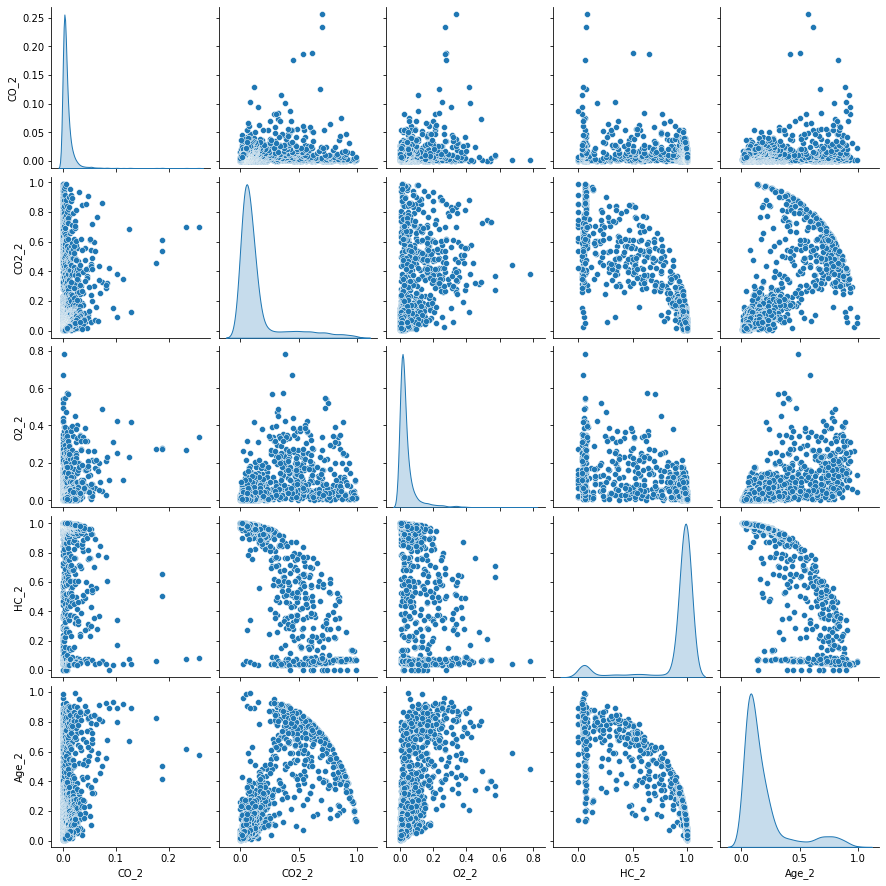

In [17]:
sns.pairplot(dataset[['CO_2', 'CO2_2', 'O2_2', 'HC_2', 'Age_2']], diag_kind='kde')

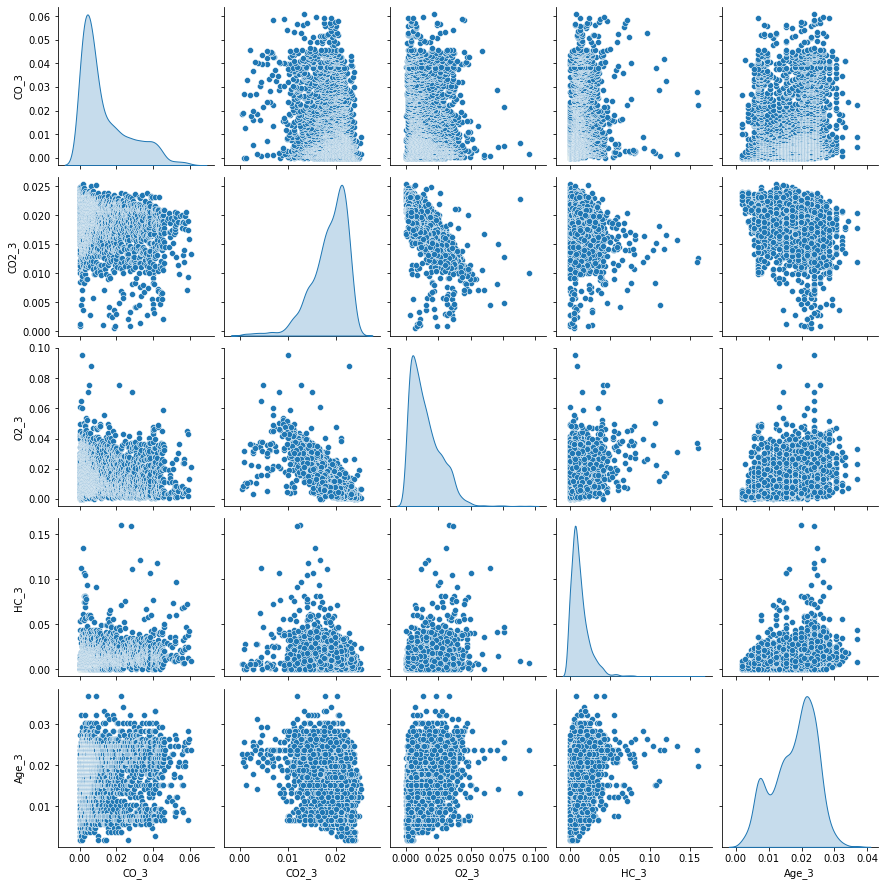

In [30]:
sns.pairplot(dataset[['CO_3', 'CO2_3', 'O2_3', 'HC_3', 'Age_3']], diag_kind='kde')

In [31]:
# dfw.to_excel("result.xlsx")
ofileName = 'o' + fileName
with pd.ExcelWriter(ofileName) as writer:  
    dataset.to_excel(writer, sheet_name='Sheet1')
    

In [25]:
X = dataset[['Age','CO','CO2','O2','HC']].to_numpy().T
X_normalized = preprocessing.normalize(X, norm='l2')
X

array([[8.00e+00, 7.00e+00, 3.00e+00, ..., 3.00e+01, 2.80e+01, 2.50e+01],
       [0.00e+00, 0.00e+00, 0.00e+00, ..., 4.51e+00, 4.55e+00, 4.65e+00],
       [1.35e+01, 1.47e+01, 1.46e+01, ..., 1.09e+01, 9.90e+00, 8.30e+00],
       [1.55e+00, 8.00e-02, 7.20e-01, ..., 1.55e+00, 3.44e+00, 5.61e+00],
       [0.00e+00, 1.00e+01, 1.00e+00, ..., 2.03e+02, 6.79e+02, 1.38e+02]])

In [22]:
X = dataset[['Age']].to_numpy()
X.T

array([[ 8,  7,  3, ..., 30, 28, 25]], dtype=int64)

In [23]:
X_normalized = preprocessing.normalize(X, norm='l2')

In [26]:
X_normalized

array([[7.58599924e-03, 6.63774933e-03, 2.84474971e-03, ...,
        2.84474971e-02, 2.65509973e-02, 2.37062476e-02],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        5.90750511e-02, 5.95989984e-02, 6.09088665e-02],
       [2.16401400e-02, 2.35637080e-02, 2.34034107e-02, ...,
        1.74724094e-02, 1.58694360e-02, 1.33046787e-02],
       [5.91824573e-03, 3.05457844e-04, 2.74912060e-03, ...,
        5.91824573e-03, 1.31346873e-02, 2.14202313e-02],
       [0.00000000e+00, 6.28369211e-04, 6.28369211e-05, ...,
        1.27558950e-02, 4.26662694e-02, 8.67149511e-03]])

In [28]:
import sklearn.preprocessing as preprocessing

X = dataset[['Age','CO','CO2','O2','HC']].to_numpy().T
X_normalized = preprocessing.normalize(X, norm='l2')
# 
df2 = pd.DataFrame(X_normalized.T)
# start index
# df2.index += 1
# df2.columns = ['Age_2','CO_2','CO2_2','O2_2','HC_2']
# dataset = pd.concat([dataset, df2], axis=1)

# dataset
df2

,0,1,2,3,4
0,0.007586,0.000000,0.021640,0.005918,0.000000
1,0.006638,0.000000,0.023564,0.000305,0.000628
2,0.002845,0.000000,0.023403,0.002749,0.000063
3,0.015172,0.000000,0.016350,0.012027,0.000063
4,0.011379,0.000000,0.023243,0.002291,0.000063
...,...,...,...,...,...
2760,0.025603,0.058813,0.009297,0.043108,0.037891
2761,0.006638,0.059075,0.019075,0.001795,0.024381
2762,0.028447,0.059075,0.017472,0.005918,0.012756
2763,0.026551,0.059599,0.015869,0.013135,0.042666
